In [7]:
import scanpy as sc
from pathlib import Path
import pandas as pd
import squidpy as sq
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# from muon import prot as pt
# from muon import MuData
# import muon as mu
import numpy as np
from jax import config
from itertools import product
from datetime import datetime

config.update("jax_enable_x64", True)
# config.update("jax_platform_name", "cpu")
# JAX_PLATFORM_NAME = "cpu"
%load_ext autoreload
%autoreload 1

path_data = Path("/lustre/groups/ml01/workspace/moscot_paper/mapping")

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [8]:
scaler = StandardScaler()

adata_sc = sc.read(path_data / "adata_sc_processed.h5ad")
adata_p = sc.read(path_data / "adata_cite_processed.h5ad")

# sc.pp.scale(adata_p)
# sc.pp.scale(adata_sc)
adata_sc.obsm["cite"] = adata_p.X.copy()

# sc.pp.pca(adata_sc, n_comps=50)
# sc.pp.pca(adata_p, n_comps=50)
# adata_sc.obsm["X_pca_protein"] = adata_p.obsm["X_pca"].copy()
# adata_sc.obsm["X_pca_protein_scaled"] = scaler.fit_transform(
#     adata_p.obsm["X_pca"].copy()
# )
# adata_sc.obsm["X_pca"] = adata_p.obsm["X_pca"].copy()
# adata_sc.obsm["X_pca_scaled"] = scaler.fit_transform(adata_p.obsm["X_pca"].copy())
# sc.pp.subsample(adata_sc, fraction=0.5)

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [9]:
adata_spatial = sc.read(path_data / "vizgen_liver/adata_result.h5ad")
adata_spatial.X = adata_spatial.layers["normalized"].copy()
sc.pp.pca(adata_spatial, n_comps=50)

spatial = adata_spatial.obsm["spatial"]

adata_spatial.obsm["spatial_scaled"] = (spatial - spatial.mean()) / spatial.std()
sc.pp.scale(adata_spatial)
adata_spatial.obsm["X_pca_scaled"] = scaler.fit_transform(adata_spatial.obsm["X_pca"])
adata_spatial.obsm["X_pca_spatial_scaled"] = np.concatenate(
    [adata_spatial.obsm["X_pca_scaled"], adata_spatial.obsm["spatial_scaled"]], axis=1
)

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [65]:
adata_p.obsm["cite2"] = adata_p.obsm["X_umap"].copy()

In [57]:
d = {
    "Endothelial cells":"ESAM",
    "Endothelial cells":"CD300LG",
    "Endothelial cells":"CD38",
    "Kupffer cells":"CD86",
    "Kupffer cells":"Tim4",
    "Kupffer cells":"Folate",
}
import jax.numpy as jnp
from ott.geometry import costs, pointcloud
from ott.problems.linear import linear_problem
from ott.solvers import linear
from ott.solvers.linear import univariate

solver = univariate.UnivariateSolver()
for celltype, protein in d.items():
    ct = adata_p.obs["annot"].isin([celltype]).values
    nct = ~ct
    x= adata_p[ct,protein].X.A#.flatten()
    y= adata_p[nct,protein].X.A#.flatten()
    a = jnp.ones(x.shape) / len(x)
    b = jnp.ones(y.shape) / len(y)
    geom = pointcloud.PointCloud(x, y, cost_fn=costs.PNormP(1.0))
    prob = linear_problem.LinearProblem(geom=geom, a=a, b=b)
    ott_d = solver(prob).ot_costs[0]

In [61]:
ott_d.item()

1.878191782656745

In [30]:


self.x = jax.random.uniform(rngs[0], [self.n])
self.y = jax.random.uniform(rngs[1], [self.m])
a = jax.random.uniform(rngs[2], [self.n])
b = jax.random.uniform(rngs[3], [self.m])

univariate_solver = univariate.UnivariateSolver(
    method="wasserstein", cost_fn=costs.PNormP(1.0)
)
ott_distance = univariate_solver(self.x, self.y, self.a, self.b)


annot
Kupffer cells                         26915
Endothelial cells                     17671
Monocytes & Monocyte-derived cells    14198
T cells                                5341
Hepatocytes                            4836
B cells                                4432
pDCs                                   3770
cDC2s                                  3408
cDC1s                                  3335
Neutrophils                            2414
ILC1s                                  1636
NK cells                               1281
Fibroblasts                             683
Mig. cDCs                               576
Cholangiocytes                          454
Basophils                                88
HsPCs                                     2
Name: count, dtype: int64

In [ ]:
import mplscience
import matplotlib.pyplot as plt

mplscience.available_styles()
mplscience.set_style(reset_current=True)
plt.rcParams["legend.scatterpoints"] = 1

In [ ]:
adata_spatial.var_names = [v.capitalize() for v in adata_spatial.var_names.values]

In [ ]:
var_names = list(
    set(adata_sc.var_names.values).intersection(adata_spatial.var_names.values)
)
len(var_names)

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


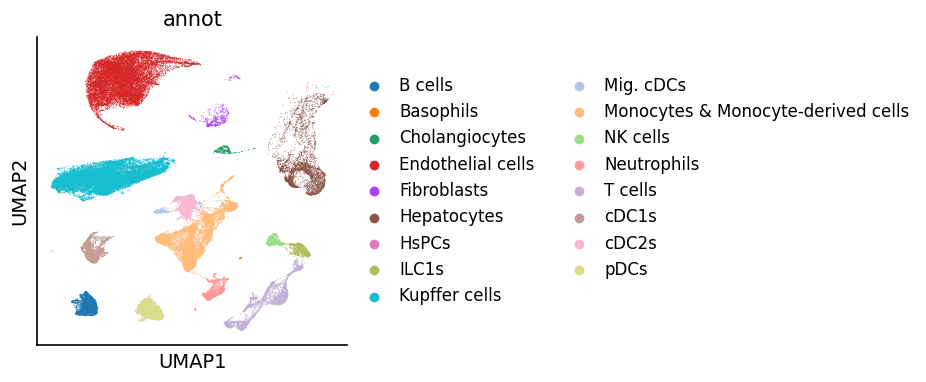

<Figure size 400x400 with 0 Axes>

In [7]:
sc.pl.umap(
    adata_sc,
    color=[
        # "n_counts",
        "annot",
    ],
)
plt.tight_layout()

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


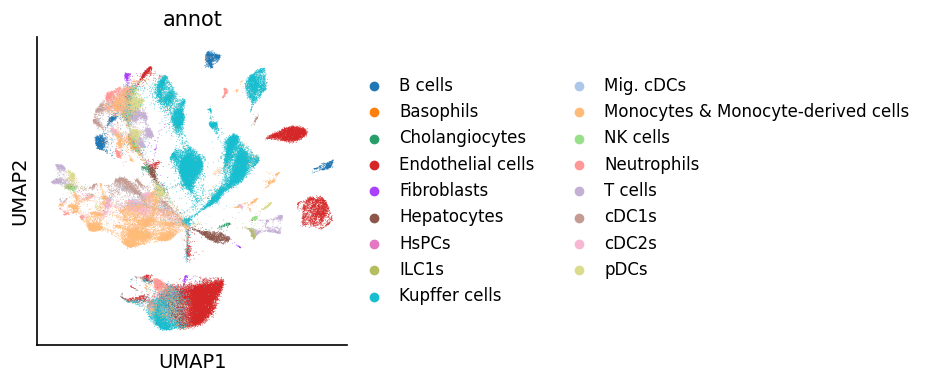

<Figure size 400x400 with 0 Axes>

In [8]:
sc.pl.umap(
    adata_p,
    color=["annot"],
)
plt.tight_layout()

In [ ]:
import anndata as ad
sc_x = adata_sc[:, var_names].copy()
sp_x = adata_spatial[:, var_names].copy()
adata_merge = ad.concat([sc_x, sp_x], label="batch", keys=["sc", "spatial"])

In [41]:
sc.pp.pca(adata_merge)
sc.pp.neighbors(adata_merge)
sc.tl.umap(adata_merge)

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 400x400 with 0 Axes>

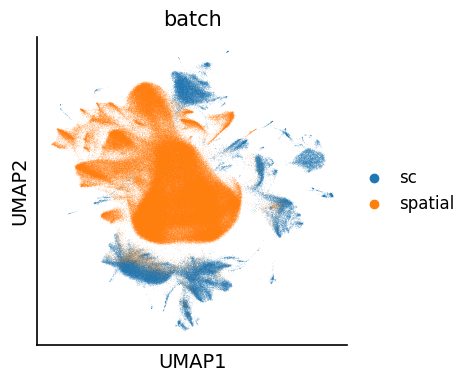

In [42]:
sc.pl.umap(
    adata_merge,
    color=["batch"],
)
plt.tight_layout()

In [8]:
from moscot.problems.space import MappingProblem

# sc.pp.subsample(adata_sc, fraction=0.1)
# sc.pp.subsample(adata_spatial, fraction=0.1)
problem = (
    MappingProblem(adata_sc, adata_spatial).prepare(
        # batch_key="batch",
        sc_attr={"attr": "obsm", "key": "cite"},
        joint_attr={"attr": "X"},
        spatial_key="X_pca_scaled",
        normalize_spatial=False,
        # normalize=True,
        var_names=var_names,
        cost="cosine",
        # xy_callback_kwargs={"n_comps": 50},
    )
    # .solve(xy_callback_kwargs=alpha=0.5, epsilon=1e-2)
)
# joint_attr={
#     "x_attr": "obsm",
#     "x_key": "X_scanorama",
#     "y_attr": "obsm",
#     "y_key": "X_scanorama",
# },

WARNING  Densifying data in `adata.X`                                                                              
WARNING  Densifying data in `adata.obsm['cite']`                                                                   


In [ ]:
# x = problem[('src', 'tgt')]._x.data_src
# y = problem[('src', 'tgt')]._y.data_src
# xy_x, xy_y = problem[('src', 'tgt')]._xy.data_src, problem[('src', 'tgt')]._xy.data_tgt

In [ ]:
# from ott.geometry import pointcloud
# from ott.problems.linear import linear_problem
# from ott.problems.quadratic import quadratic_problem
# from ott.solvers.linear import sinkhorn, sinkhorn_lr
# from ott.solvers.quadratic import gromov_wasserstein_lr

# geom_xx = pointcloud.PointCloud(x, epsilon=0, scale_cost="mean")
# geom_yy = pointcloud.PointCloud(y, epsilon=0, scale_cost="mean")
# geom_xy = pointcloud.PointCloud(xy_x, xy_y, epsilon=0, scale_cost="mean")

# prob = quadratic_problem.QuadraticProblem(
#     geom_xx,
#     geom_yy,
#     geom_xy=geom_xy,
#     fused_penalty=9.0,
# )

In [10]:
n = len(adata_sc)
m = len(adata_spatial)
rank = 200
tol = 1e-2
n_subset = min(int(rank / tol), n, m)
n_subset

20000

In [11]:
from datetime import datetime

start_time = datetime.now()
problem = problem.solve(
    alpha=0.1,
    rank=10,
    epsilon=0,
    gamma=1,
    initializer="random",
    max_iterations=20_000,
    # gamma=10,
    threshold=1e-20,
    # tau_a=0.1,
    # tau_b=0.95
)
end_time = datetime.now()

INFO     Solving `1` problems                                                                                      
INFO     Solving problem OTProblem[stage='prepared', shape=(367235, 91040)].                                       
{'epsilon': 0, 'min_iterations': 5, 'max_iterations': 20000, 'threshold': 1e-20, 'gamma': 1}


2024-01-10 13:33:25.450420: W external/xla/xla/service/platform_util.cc:198] unable to create StreamExecutor for CUDA:0: failed initializing StreamExecutor for CUDA device ordinal 0: INTERNAL: failed call to cuDevicePrimaryCtxRetain: CUDA_ERROR_OUT_OF_MEMORY: out of memory; total memory reported: 84986691584
CUDA backend failed to initialize: INTERNAL: no supported devices found for platform CUDA (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


XlaRuntimeError: RESOURCE_EXHAUSTED: Out of memory allocating 3904218784744 bytes.

In [ ]:
print(end_time - start_time)

In [ ]:
problem.problems[("src", "tgt")].solution._output.ot_prob.geom_xy

In [25]:
# problem.problems[("src", "tgt")].solution._output

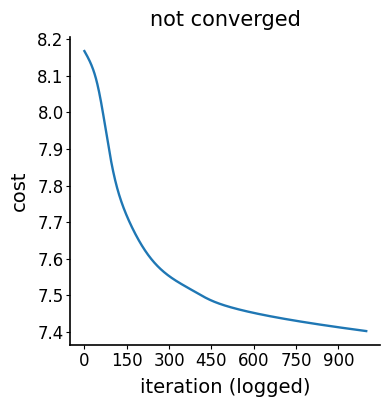

In [28]:
problem.problems[("src", "tgt")].solution.plot_costs()

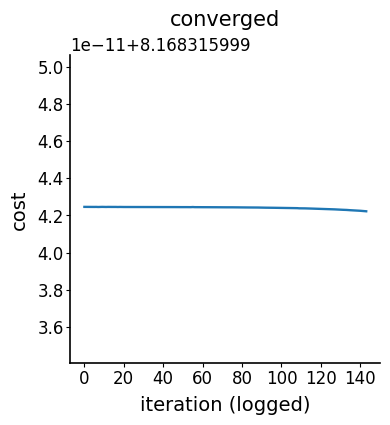

In [15]:
problem.problems[("src", "tgt")].solution.plot_costs()

In [21]:
problem.problems[("src", "tgt")].solution.rank

400

In [14]:
import ott

In [15]:
ott.__version__

'0.4.5.dev31+ge054ff6'

In [68]:
problem.save(path_data / "output_new", overwrite=True)

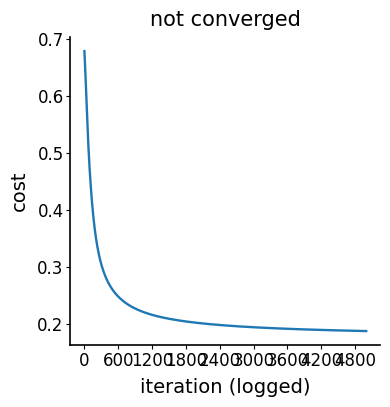

In [30]:
# problem = problem.load(path_data / "output_new")
problem.problems[("src", "tgt")].solution.plot_costs()

In [12]:
from anndata import AnnData

prot = adata_p[adata_sc.obs_names].X
spatial_prot = problem.problems[("src", "tgt")].solution.pull(
    prot,
    scale_by_marginals=True,
)
adata_spatial_prot = AnnData(
    np.array(spatial_prot), obs=adata_spatial.obs.copy(), obsm=adata_spatial.obsm.copy()
)
adata_spatial_prot.var_names = adata_p.var_names.copy()

2023-11-09 08:33:08.459333: W external/xla/xla/service/gpu/nvptx_compiler.cc:679] The NVIDIA driver's CUDA version is 12.2 which is older than the ptxas CUDA version (12.3.52). Because the driver is older than the ptxas version, XLA is disabling parallel compilation, which may slow down compilation. You should update your NVIDIA driver or use the NVIDIA-provided CUDA forward compatibility packages.


In [13]:
genes = ["Gja5", "Adgrg6", "Mmrn1", "Epcam", "Spp1"]
adata_sc[:, genes]

View of AnnData object with n_obs × n_vars = 91040 × 5
    obs: 'cluster', 'annot', 'sample', 'cell', 'digest', 'typeSample'
    var: 'n_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'annot_colors', 'hvg', 'pca', 'sample_colors'
    obsm: 'X_pca', 'X_umap', 'joint_pca', 'cite'
    varm: 'PCs'
    layers: 'counts'

In [14]:
from anndata import AnnData

gexp = adata_sc[adata_sc.obs_names, genes].X
spatial_gexp = problem.problems[("src", "tgt")].solution.pull(
    gexp,
    scale_by_marginals=True,
)
adata_spatial_gexp = AnnData(
    np.array(spatial_gexp), obs=adata_spatial.obs.copy(), obsm=adata_spatial.obsm.copy()
)
adata_spatial_gexp.var_names = genes

In [15]:
adata_spatial_prot.X.max()

0.5073585873925466

In [16]:
adata_spatial_gexp.X.max()

0.031643692774743784

In [17]:
adata_spatial_prot.obs["Cell_Type"] = adata_spatial.obs["Cell_Type"].copy()

In [18]:
dummy = pd.get_dummies(adata_sc.obs["annot"])

In [19]:
temp = problem[("src", "tgt")].pull(dummy, scale_by_marginals=False)
temp.shape

(367235, 17)

In [20]:
clusters = pd.Categorical([dummy.columns[i] for i in np.array(temp.argmax(1))])
clusters.value_counts()

Basophils       15268
Fibroblasts     48991
HsPCs          172446
ILC1s           34136
Mig. cDCs       56784
NK cells        23549
Neutrophils      3035
pDCs            13026
Name: count, dtype: int64

In [21]:
adata_spatial_prot.obs["celltype_mapped"] = clusters

In [22]:
adata_spatial_prot.obs["celltype_mapped"].cat.categories

Index(['Basophils', 'Fibroblasts', 'HsPCs', 'ILC1s', 'Mig. cDCs', 'NK cells',
       'Neutrophils', 'pDCs'],
      dtype='object')

In [23]:
adata_sc.obs["annot"].cat.categories

Index(['B cells', 'Basophils', 'Cholangiocytes', 'Endothelial cells',
       'Fibroblasts', 'Hepatocytes', 'HsPCs', 'ILC1s', 'Kupffer cells',
       'Mig. cDCs', 'Monocytes & Monocyte-derived cells', 'NK cells',
       'Neutrophils', 'T cells', 'cDC1s', 'cDC2s', 'pDCs'],
      dtype='object')

In [24]:
adata_spatial_prot.uns["celltype_mapped_colors"] = adata_sc.uns["annot_colors"].copy()

In [25]:
# adata_spatial_prot.obs["celltype_mapped"].unique()
adata_spatial_prot.uns.pop("celltype_mapped_colors")

array(['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b',
       '#e377c2', '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a',
       '#ff9896', '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d'],
      dtype=object)

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/squidpy/pl/_spatial_utils.py:747: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if c is not None and c in adata.obs and is_categorical_dtype(adata.obs[c]):
/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/squidpy/pl/_spatial_utils.py:471: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(color_source_vector):
/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.10/site-packages/squidpy/pl/_spatial_utils.py:483: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = color

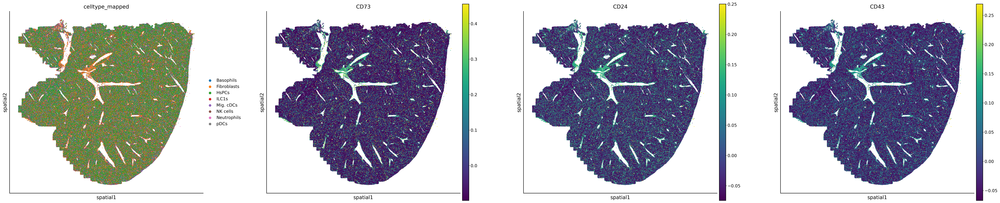

In [26]:
sq.pl.spatial_scatter(
    adata_spatial_prot,
    shape=None,
    color=["celltype_mapped", "CD73", "CD24", "CD43"],
    # groups="Neutrophils",
    size=1,
    figsize=(10, 10),
    dpi=300,
)

In [36]:
# df = problem.cell_transition(
#     source="src",
#     target="tgt",
#     source_groups="leiden",
#     target_groups="annot",
#     forward=True,
#     aggregation_mode="cell",
#     batch_size=1024,
# )
# df.shape
# adata_spatial_prot.shape

In [37]:
# df.to_csv(path_data / "cell_transition_score.csv.gz")

In [27]:
adata_spatial_prot.write(path_data / "adata_spatial_protein_out_new.h5ad")

adata_sc.write(path_data / "adata_sc_out_new.h5ad")

In [28]:
adata_spatial_gexp.write(path_data / "adata_spatial_gexp_out_new.h5ad")

In [29]:
adata_spatial.write(path_data / "adata_spatial_out_new.h5ad")

In [41]:
# sc.pl.umap(adata_sc, color=["Epcam", "Gja5", "annot"])